<a href="https://colab.research.google.com/github/feelthevenom/Plant_Disease_Segmentation/blob/main/Plant_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Plant Disease Segmentation using UNet Model**

#### Auther    : Rahul Ravikumar
#### code_name : feelthevenom
#### LinkedIn  : https://www.linkedin.com/in/rahul-ravikumar-08805b121/
#### GitHub    : https://github.com/feelthevenom
#### Medium    : https://medium.com/@rahul.valli2003
#### Kaggle    : https://www.kaggle.com/feelthevenom



In [1]:
!pip install segmentation-models-pytorch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.5/68.5 kB 5.0 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  U

In [2]:
!pip install -q -U segmentation-models-pytorch albumentations > /dev/null

## Library import and Gdrive connect

In [3]:
import os, cv2
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
from sklearn.model_selection import train_test_split
import segmentation_models_pytorch as smp
from torch.utils.tensorboard import SummaryWriter
import datetime
import matplotlib.pyplot as plt
import albumentations as album
import random

In [4]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Data Seperation

In [69]:
import os
import shutil
import random

# Paths for data directories
DATA_DIR = '/content/drive/MyDrive/orig_data'

train_images = os.path.join(DATA_DIR, 'train_images')
train_masks = os.path.join(DATA_DIR, 'train_masks')

print("Before Splitting the train and test")
print(len(os.listdir(train_images)))
print(len(os.listdir(train_masks)))

# Directories for test data
test_images = os.path.join(DATA_DIR, 'test_images')
test_masks = os.path.join(DATA_DIR, 'test_masks')

valid_images = os.path.join(DATA_DIR, 'valid_images')
valid_masks = os.path.join(DATA_DIR, 'valid_masks')

# Create test directories if they don't exist
os.makedirs(test_images, exist_ok=True)
os.makedirs(test_masks, exist_ok=True)

# List all files in train_images and train_masks directories
image_files = os.listdir(train_images)
mask_files = os.listdir(train_masks)

# Sort the lists to ensure correspondence between images and masks
image_files.sort()
mask_files.sort()

# Ensure each image has a corresponding mask
assert len(image_files) == len(mask_files)

# Determine the number of test samples (10% of the total dataset)
num_test_samples = int(len(image_files) * 0.1)

# Randomly select indices for the test samples
test_indices = random.sample(range(len(image_files)), num_test_samples)

# Move the selected files to the test directories
for i in test_indices:
    image_file = image_files[i]
    mask_file = mask_files[i]

    # Define source and destination paths
    image_src = os.path.join(train_images, image_file)
    image_dest = os.path.join(test_images, image_file)

    mask_src = os.path.join(train_masks, mask_file)
    mask_dest = os.path.join(test_masks, mask_file)

    # Move the files
    shutil.move(image_src, image_dest)
    shutil.move(mask_src, mask_dest)

print(f"Moved {num_test_samples} images and masks to the test set.")

Moved 44 images and masks to the test set.


##To check RGB class in binary masked image

In [70]:
import numpy as np
from PIL import Image

def find_unique_colors(image_path):
    """
    Find unique RGB colors in an image.

    Args:
        image_path (str): Path to the labeled image.

    Returns:
        list: List of unique RGB colors in the image.
    """
    # Load the image
    image = Image.open(image_path).convert('RGB')

    # Convert the image to a NumPy array
    image_array = np.array(image)

    # Find unique colors in the image
    unique_colors = np.unique(image_array.reshape(-1, image_array.shape[2]), axis=0)

    # Convert unique colors to a list of tuples
    unique_colors_list = [tuple(color) for color in unique_colors]

    return unique_colors_list

# Example usage
image_path = test_masks + '/00002.png'
unique_colors = find_unique_colors(image_path)

color = []
print("Unique RGB colors in the image:")
for idx, color in enumerate(unique_colors):
    print(f"Class {idx}: {color}")


Unique RGB colors in the image:
Class 0: (0, 0, 0)
Class 1: (128, 0, 0)


In [48]:
print(len(os.listdir(train_images)))
print(len(os.listdir(train_masks)))
print(len(os.listdir(test_images)))
print(len(os.listdir(test_masks)))
print(len(os.listdir(valid_images)))
print(len(os.listdir(valid_masks)))

498

## Set Classes

In [72]:
# Get class names
class_names = ['background','affected']
# Get class RGB values
class_rgb_values = [[0, 0, 0], color] ## [0,0,0] for black background [color] for masked image

# Useful to shortlist specific classes in datasets with large number of classes
select_classes = class_names

# Get RGB values of required classes
select_class_indices = [class_names.index(cls.lower()) for cls in select_classes]
select_class_rgb_values =  np.array(class_rgb_values)[select_class_indices]

print('Selected classes and their corresponding RGB values in labels:')
print('Class Names: ', class_names)
print('Class RGB values: ', class_rgb_values)

Selected classes and their corresponding RGB values in labels:
Class Names:  ['background', 'affected']
Class RGB values:  [[0, 0, 0], [128, 0, 0]]


## Custom Class for Pre Process

In [73]:
# helper function for data visualization
def visualize(**images):
    """
    Plot images in one row
    """
    n_images = len(images)
    plt.figure(figsize=(20,8))
    for idx, (name, image) in enumerate(images.items()):
        plt.subplot(1, n_images, idx + 1)
        plt.xticks([]);
        plt.yticks([])
        # get title from the parameter names
        plt.title(name.replace('_',' ').title(), fontsize=20)
        plt.imshow(image)
    plt.show()

# Perform one hot encoding on label
def one_hot_encode(label, label_values):
    """
    Convert a segmentation image label array to one-hot format
    by replacing each pixel value with a vector of length num_classes
    # Arguments
        label: The 2D array segmentation image label
        label_values

    # Returns
        A 2D array with the same width and hieght as the input, but
        with a depth size of num_classes
    """
    semantic_map = []
    for colour in label_values:
        equality = np.equal(label, colour)
        class_map = np.all(equality, axis = -1)
        semantic_map.append(class_map)
    semantic_map = np.stack(semantic_map, axis=-1)

    return semantic_map

# Perform reverse one-hot-encoding on labels / preds
def reverse_one_hot(image):
    """
    Transform a 2D array in one-hot format (depth is num_classes),
    to a 2D array with only 1 channel, where each pixel value is
    the classified class key.
    # Arguments
        image: The one-hot format image

    # Returns
        A 2D array with the same width and hieght as the input, but
        with a depth size of 1, where each pixel value is the classified
        class key.
    """
    x = np.argmax(image, axis = -1)
    return x

# Perform colour coding on the reverse-one-hot outputs
def colour_code_segmentation(image, label_values):
    """
    Given a 1-channel array of class keys, colour code the segmentation results.
    # Arguments
        image: single channel array where each value represents the class key.
        label_values

    # Returns
        Colour coded image for segmentation visualization
    """
    colour_codes = np.array(label_values)
    x = colour_codes[image.astype(int)]

    return x

## Plant Dataset class

In [74]:
class PlantDiseaseDataset(torch.utils.data.Dataset):
    def __init__(
            self,
            images_dir,
            masks_dir,
            class_rgb_values=None,
            augmentation=None,
            preprocessing=None,
    ):

        self.image_paths = [os.path.join(images_dir, image_id) for image_id in sorted(os.listdir(images_dir))]
        self.mask_paths = [os.path.join(masks_dir, image_id) for image_id in sorted(os.listdir(masks_dir))]

        self.class_rgb_values = class_rgb_values
        self.augmentation = augmentation
        self.preprocessing = preprocessing

    def __getitem__(self, i):

        # read images and masks
        image = cv2.cvtColor(cv2.imread(self.image_paths[i]), cv2.COLOR_BGR2RGB)
        mask = cv2.cvtColor(cv2.imread(self.mask_paths[i]), cv2.COLOR_BGR2RGB)

        #Resize the image to 256 X 256
        image = cv2.resize(image, (256, 256), interpolation=cv2.INTER_LINEAR)
        mask = cv2.resize(mask, (256, 256), interpolation=cv2.INTER_NEAREST)

        # one-hot-encode the mask
        mask = one_hot_encode(mask, self.class_rgb_values).astype('float')

        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

        # apply preprocessing
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

        return image, mask

    def __len__(self):
        # return length of
        return len(self.image_paths)

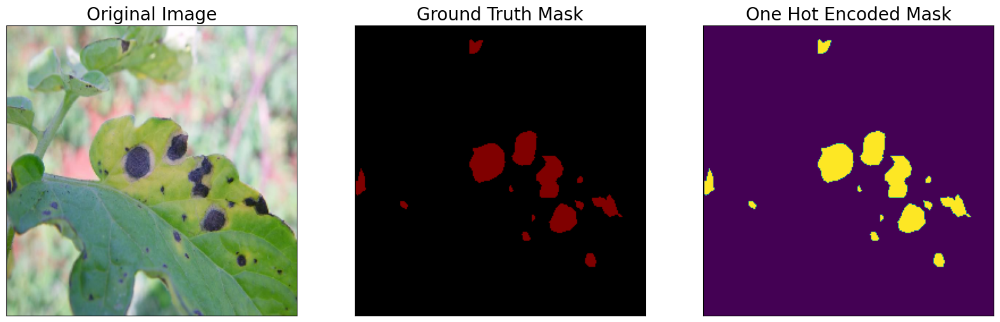

In [75]:
dataset = PlantDiseaseDataset(train_images, train_masks, class_rgb_values=select_class_rgb_values)
random_idx = random.randint(0, len(dataset)-1)
image, mask = dataset[2]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

## Augmented Image

In [76]:
def get_training_augmentation():
    train_transform = [
        album.OneOf(
            [
                album.HorizontalFlip(p=1),
                album.VerticalFlip(p=1),
                album.RandomRotate90(p=1),  # Add more augmentation
            ],
            p=0.75,
        ),
    ]
    return album.Compose(train_transform)


def get_validation_augmentation():
    """Add paddings to make image shape divisible by 32"""
    test_transform = [
        album.PadIfNeeded(
            min_height=256,
            min_width=256,
            always_apply=True,
            border_mode=0, # cv2.BORDER_CONSTANT
            value=0 # Black padding
        ),
    ]
    return album.Compose(test_transform)


def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')


def get_preprocessing(preprocessing_fn=None):
    """Construct preprocessing transform
    Args:
        preprocessing_fn (callable): data normalization function
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose
    """
    _transform = []
    if preprocessing_fn:
        _transform.append(album.Lambda(image=preprocessing_fn))
    _transform.append(album.Lambda(image=to_tensor, mask=to_tensor))

    return album.Compose(_transform)

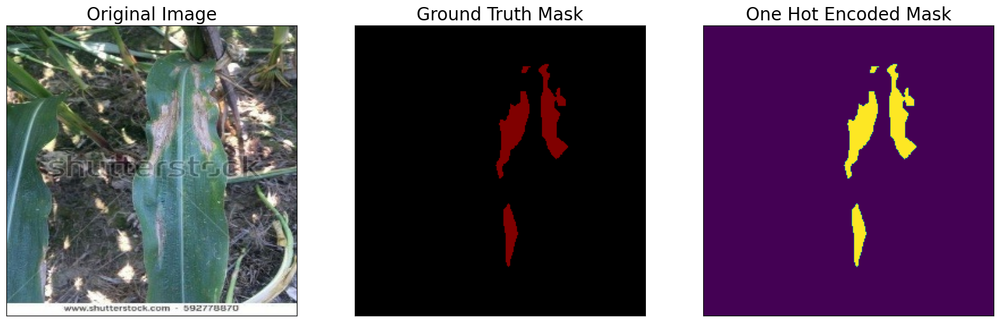

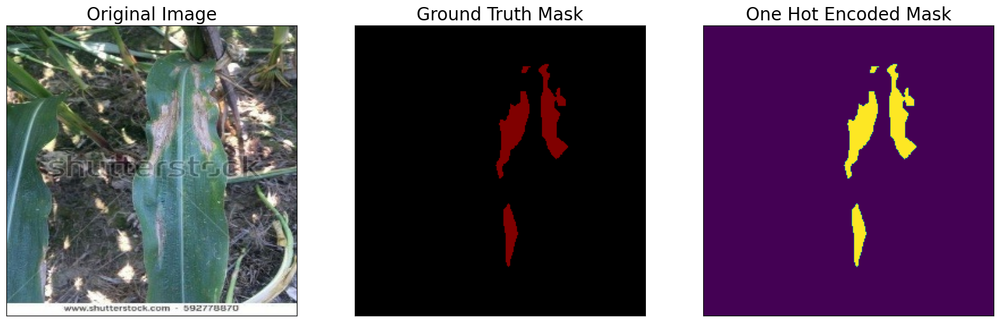

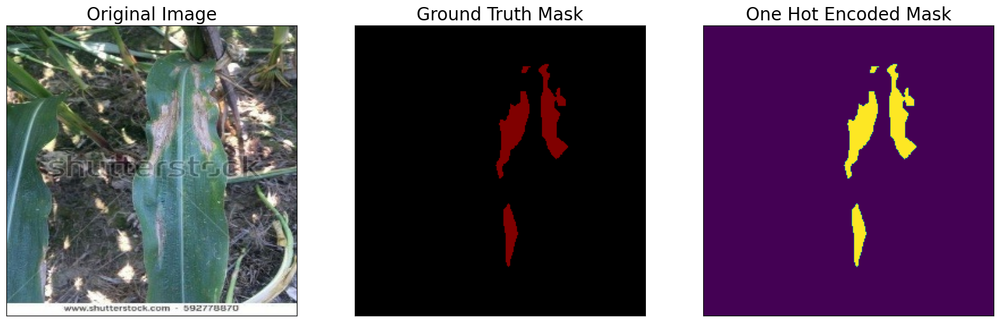

In [77]:
augmented_dataset = PlantDiseaseDataset(
    train_images, train_masks,
    augmentation=get_training_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

random_idx = random.randint(0, len(augmented_dataset)-1)

# Different augmentations on a random image/mask pair (256*256 crop)
for i in range(3):
    image, mask = augmented_dataset[random_idx]
    visualize(
        original_image = image,
        ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
        one_hot_encoded_mask = reverse_one_hot(mask)
    )

## Model Architecture

In [64]:
import segmentation_models_pytorch as smp

model = smp.Unet(
    encoder_name="resnet50",
    encoder_weights="imagenet",
    in_channels=3,
    classes=2,
    activation='sigmoid',
)

In [65]:
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [66]:
from torchsummary import summary
input_size = (3,256, 256)  # 2 samples in the batch, 3 channels, 256x256 resolution

# Generate the model summary with a batch size of 8
summary(model.to(DEVICE), input_size=input_size, batch_size=16)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [16, 64, 128, 128]           9,408
       BatchNorm2d-2         [16, 64, 128, 128]             128
              ReLU-3         [16, 64, 128, 128]               0
         MaxPool2d-4           [16, 64, 64, 64]               0
            Conv2d-5           [16, 64, 64, 64]           4,096
       BatchNorm2d-6           [16, 64, 64, 64]             128
              ReLU-7           [16, 64, 64, 64]               0
            Conv2d-8           [16, 64, 64, 64]          36,864
       BatchNorm2d-9           [16, 64, 64, 64]             128
             ReLU-10           [16, 64, 64, 64]               0
           Conv2d-11          [16, 256, 64, 64]          16,384
      BatchNorm2d-12          [16, 256, 64, 64]             512
           Conv2d-13          [16, 256, 64, 64]          16,384
      BatchNorm2d-14          [16, 256,

## Train and Validation Instance

In [78]:
import segmentation_models_pytorch.utils

In [79]:
# Get train and val dataset instances
train_dataset = PlantDiseaseDataset(
    train_images, train_masks,
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn=None),
    class_rgb_values=select_class_rgb_values,
)

valid_dataset = PlantDiseaseDataset(
    valid_images, valid_masks,
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn=None),
    class_rgb_values=select_class_rgb_values,
)

# Get train and val data loaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=12)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False, num_workers=4)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


## Hyper Parameter Tunning

In [84]:
# Set flag to train the model or not. If set to 'False', only prediction is performed (using an older model checkpoint)
TRAINING = True

# Set num of epochs
EPOCHS = 20

# Set device: `cuda` or `cpu`
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# define loss function
loss = smp.utils.losses.DiceLoss()

# define metrics
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
]

# define optimizer
optimizer = torch.optim.Adam([
    dict(params=model.parameters(), lr=0.0001),
])

# define learning rate scheduler (not used in this NB)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)

## Choose the model Path

In [87]:
m_path = '/content/drive/MyDrive/Plant_disease_UNet.pth'

#load best saved model checkpoint from previous commit (if present)
if os.path.exists(m_path):
    model = torch.load(m_path, map_location=DEVICE)

In [88]:
train_epoch = smp.utils.train.TrainEpoch(
    model,
    loss=loss,
    metrics=metrics,
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model,
    loss=loss,
    metrics=metrics,
    device=DEVICE,
    verbose=True,
)

## Model Training

In [89]:
%%time

if TRAINING:

    best_iou_score = 0.0
    train_logs_list, valid_logs_list = [], []

    for i in range(0, EPOCHS):

        # Perform training & validation
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(valid_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        # Save model if a better val IoU score is obtained
        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, m_path)
            print('Model saved!')


Epoch: 0
train:   0%|          | 0/26 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


valid:   0%|          | 0/90 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


valid: 100%|██████████| 90/90 [00:03<00:00, 27.99it/s, dice_loss - 0.09565, iou_score - 0.8454]
Model saved!

Epoch: 1
valid: 100%|██████████| 90/90 [00:03<00:00, 26.73it/s, dice_loss - 0.09596, iou_score - 0.845]

Epoch: 2
valid: 100%|██████████| 90/90 [00:03<00:00, 27.76it/s, dice_loss - 0.09491, iou_score - 0.8464]
Model saved!

Epoch: 3
valid: 100%|██████████| 90/90 [00:03<00:00, 27.02it/s, dice_loss - 0.0967, iou_score - 0.8441]

Epoch: 4
valid: 100%|██████████| 90/90 [00:03<00:00, 27.34it/s, dice_loss - 0.09516, iou_score - 0.8461]

Epoch: 5
valid: 100%|██████████| 90/90 [00:03<00:00, 27.43it/s, dice_loss - 0.09597, iou_score - 0.8442]

Epoch: 6
valid: 100%|██████████| 90/90 [00:03<00:00, 27.75it/s, dice_loss - 0.09501, iou_score - 0.8471]
Model saved!

Epoch: 7
valid: 100%|██████████| 90/90 [00:03<00:00, 27.58it/s, dice_loss - 0.0954, iou_score - 0.8461]

Epoch: 8
valid: 100%|██████████| 90/90 [00:03<00:00, 26.05it/s, dice_loss - 0.0954, iou_score - 0.8453]

Epoch: 9
valid: 100%

# Testing Model

In [90]:
# load best saved model checkpoint from the current run
if os.path.exists(m_path):
    best_model = torch.load(m_path, map_location=DEVICE)
    print('Loaded UNet model from this run.')

# load best saved model checkpoint from previous commit (if present)
elif os.path.exists(m_path):
    best_model = torch.load(m_path, map_location=DEVICE)
    print('Loaded UNet model from a previous commit.')

Loaded UNet model from this run.


In [91]:
test_dataset = PlantDiseaseDataset(
    test_images,
    test_masks,
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn=None),
    class_rgb_values=select_class_rgb_values,
)

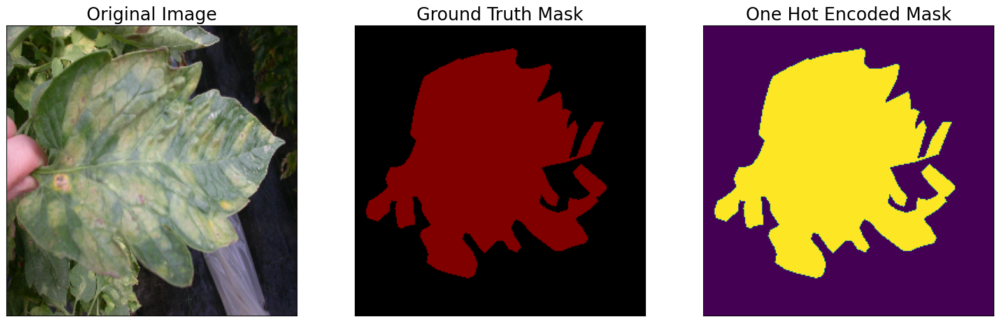

In [92]:
test_dataloader = DataLoader(test_dataset)

# test dataset for visualization (without preprocessing transformations)
test_dataset_vis = PlantDiseaseDataset(
    test_images, test_masks,
    augmentation=get_validation_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

# get a random test image/mask index
random_idx = random.randint(0, len(test_dataset_vis)-1)
image, mask = test_dataset_vis[random_idx]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

In [93]:
# Center crop padded image / mask to original image dims
def crop_image(image, target_image_dims=[1500,1500,3]):

    target_size = target_image_dims[0]
    image_size = len(image)
    padding = (image_size - target_size) // 2

    return image[
        padding:image_size - padding,
        padding:image_size - padding,
        :,
    ]

In [94]:
sample_preds_folder = 'sample_predictions/'
if not os.path.exists(sample_preds_folder):
    os.makedirs(sample_preds_folder)

In [54]:
len(test_dataset)

498

## Predicting Model

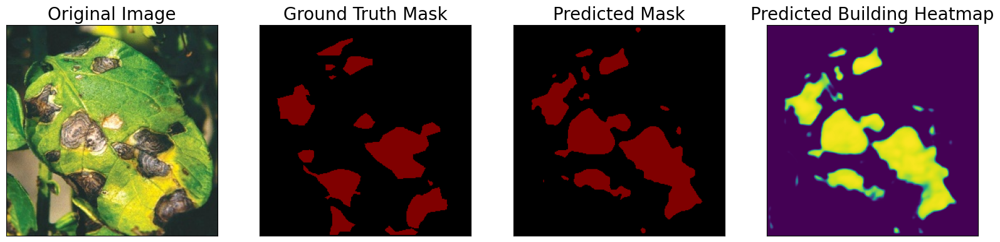

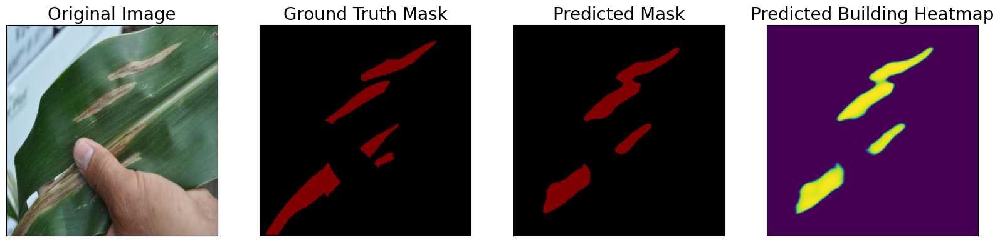

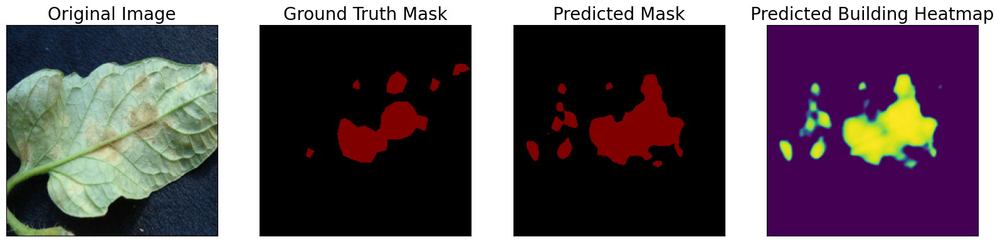

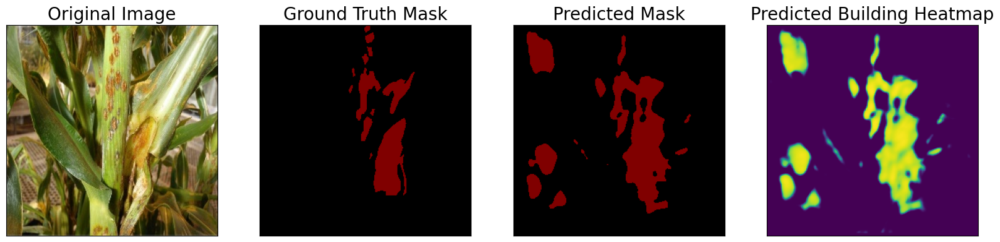

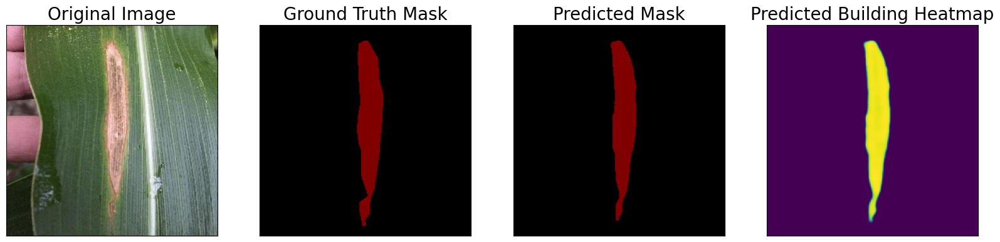

...

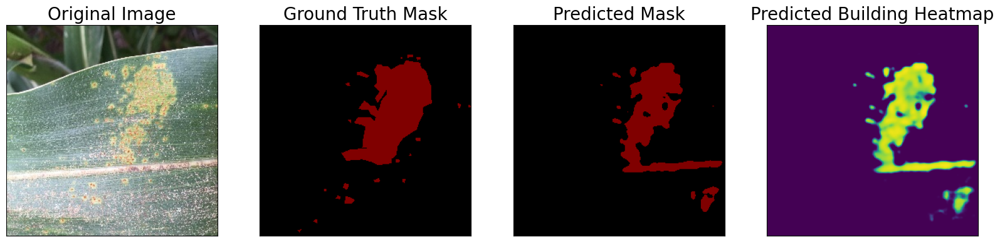

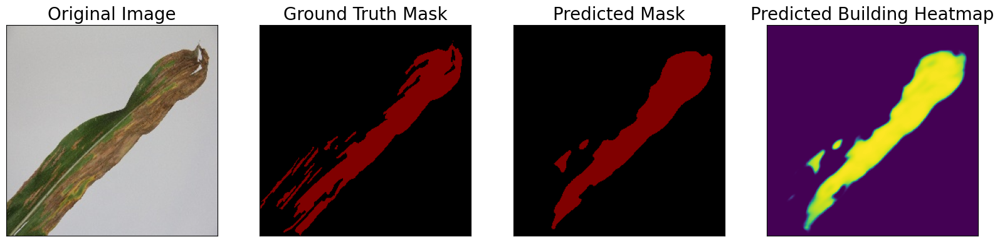

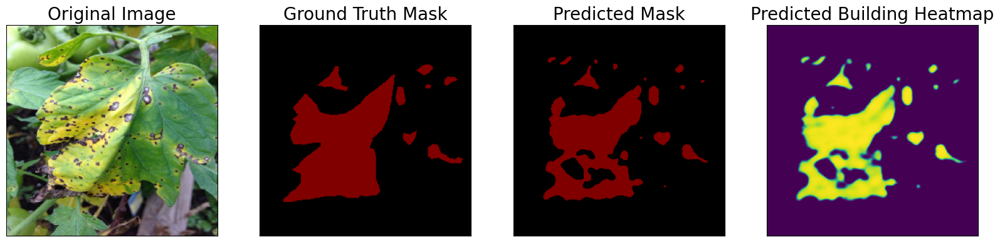

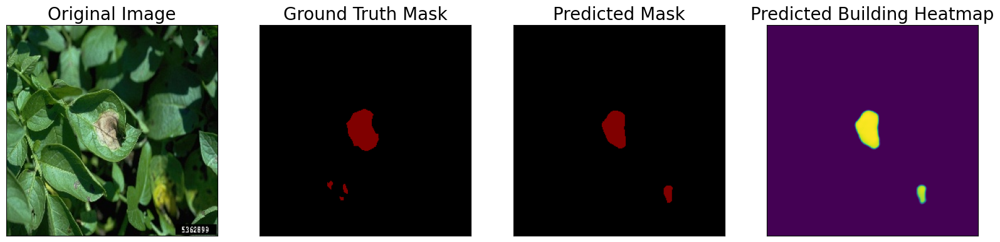

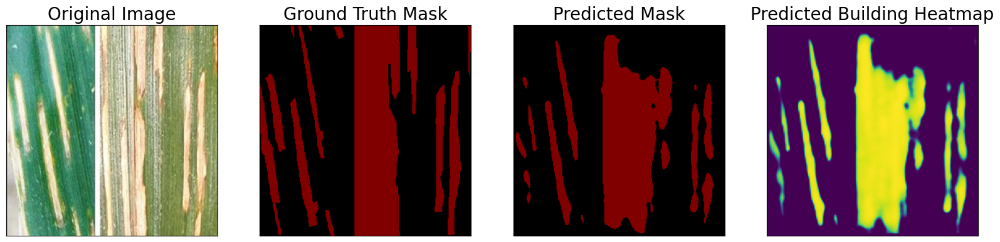

In [95]:
for idx in range(len(test_dataset)):

    random_idx = random.randint(0, len(test_dataset)-1)
    image, gt_mask = test_dataset[random_idx]
    image_vis = crop_image(test_dataset_vis[random_idx][0].astype('uint8'))
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)

    # Predict test image
    pred_mask = best_model(x_tensor)
    pred_mask = pred_mask.detach().squeeze().cpu().numpy()

    # Convert pred_mask from `CHW` format to `HWC` format
    pred_mask = np.transpose(pred_mask,(1,2,0))

    # Get prediction channel corresponding to building
    pred_building_heatmap = pred_mask[:,:,select_classes.index('affected')]
    pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))

    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = np.transpose(gt_mask,(1,2,0))
    gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))
    cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.png"), np.hstack([image_vis, gt_mask, pred_mask])[:,:,::-1])

    visualize(
        original_image = image_vis,
        ground_truth_mask = gt_mask,
        predicted_mask = pred_mask,
        # predicted_building_heatmap = pred_building_heatmap  #For Heat Map
    )

In [96]:
test_epoch = smp.utils.train.ValidEpoch(
    model,
    loss=loss,
    metrics=metrics,
    device=DEVICE,
    verbose=True,
)

valid_logs = test_epoch.run(test_dataloader)
print("Evaluation on Test Data: ")
print(f"Mean IoU Score: {valid_logs['iou_score']:.4f}")
print(f"Mean Dice Loss: {valid_logs['dice_loss']:.4f}")

valid: 100%|██████████| 93/93 [00:05<00:00, 17.94it/s, dice_loss - 0.07151, iou_score - 0.8797]
Evaluation on Test Data: 
Mean IoU Score: 0.8797
Mean Dice Loss: 0.0715


In [98]:
import pandas as pd

train_logs_df = pd.DataFrame(train_logs_list)
valid_logs_df = pd.DataFrame(valid_logs_list)
train_logs_df.T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
dice_loss,0.090934,0.094061,0.091694,0.091758,0.091461,0.094780,0.092928,0.093173,0.091594,0.090162,0.089063,0.093563,0.092796,0.092769,0.093302,0.092869,0.093018,0.092172,0.093481,0.092333
iou_score,0.840757,0.836334,0.839274,0.839526,0.839904,0.834552,0.837707,0.837047,0.839477,0.842287,0.843991,0.836500,0.837332,0.837608,0.836400,0.837432,0.837040,0.838411,0.836739,0.838054


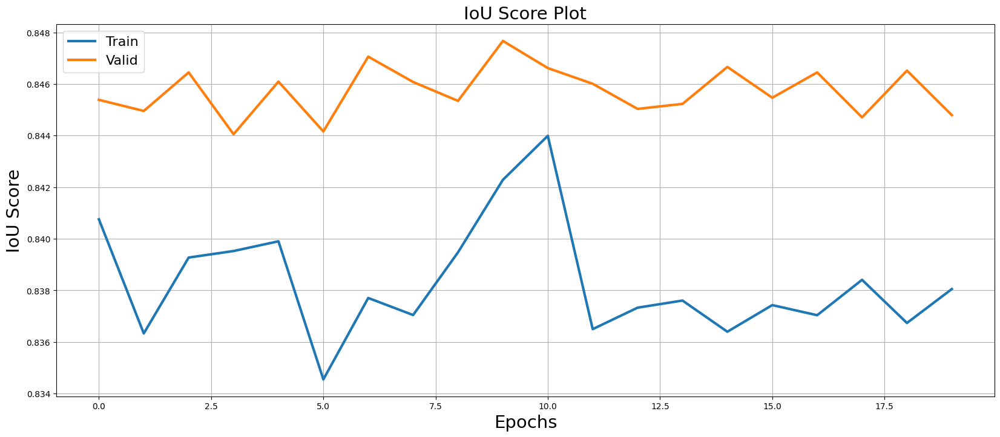

In [99]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.iou_score.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.iou_score.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=21)
plt.ylabel('IoU Score', fontsize=21)
plt.title('IoU Score Plot', fontsize=21)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('iou_score_plot.png')
plt.show()

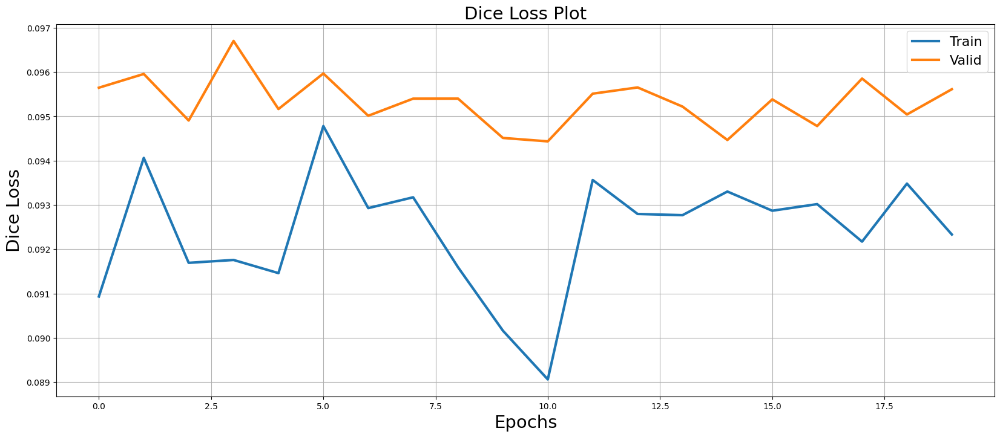

In [100]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.dice_loss.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.dice_loss.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=21)
plt.ylabel('Dice Loss', fontsize=21)
plt.title('Dice Loss Plot', fontsize=21)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('dice_loss_plot.png')
plt.show()